In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

In [2]:
for dirname, _, filenames in os.walk('facial-keypoints-detection'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

facial-keypoints-detection\IdLookupTable.csv
facial-keypoints-detection\SampleSubmission.csv
facial-keypoints-detection\test.csv
facial-keypoints-detection\training.csv


In [3]:
df_train= pd.read_csv(r"facial-keypoints-detection\training.csv")
df_sub= pd.read_csv(r"facial-keypoints-detection\SampleSubmission.csv")

In [4]:
df_train.shape

(7049, 31)

In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7049 entries, 0 to 7048
Data columns (total 31 columns):
left_eye_center_x            7039 non-null float64
left_eye_center_y            7039 non-null float64
right_eye_center_x           7036 non-null float64
right_eye_center_y           7036 non-null float64
left_eye_inner_corner_x      2271 non-null float64
left_eye_inner_corner_y      2271 non-null float64
left_eye_outer_corner_x      2267 non-null float64
left_eye_outer_corner_y      2267 non-null float64
right_eye_inner_corner_x     2268 non-null float64
right_eye_inner_corner_y     2268 non-null float64
right_eye_outer_corner_x     2268 non-null float64
right_eye_outer_corner_y     2268 non-null float64
left_eyebrow_inner_end_x     2270 non-null float64
left_eyebrow_inner_end_y     2270 non-null float64
left_eyebrow_outer_end_x     2225 non-null float64
left_eyebrow_outer_end_y     2225 non-null float64
right_eyebrow_inner_end_x    2270 non-null float64
right_eyebrow_inner_end_y 

In [6]:
df_train.fillna(method='ffill',inplace=True)

In [7]:
df_train.isna().sum()/len(df_train)

left_eye_center_x            0.0
left_eye_center_y            0.0
right_eye_center_x           0.0
right_eye_center_y           0.0
left_eye_inner_corner_x      0.0
left_eye_inner_corner_y      0.0
left_eye_outer_corner_x      0.0
left_eye_outer_corner_y      0.0
right_eye_inner_corner_x     0.0
right_eye_inner_corner_y     0.0
right_eye_outer_corner_x     0.0
right_eye_outer_corner_y     0.0
left_eyebrow_inner_end_x     0.0
left_eyebrow_inner_end_y     0.0
left_eyebrow_outer_end_x     0.0
left_eyebrow_outer_end_y     0.0
right_eyebrow_inner_end_x    0.0
right_eyebrow_inner_end_y    0.0
right_eyebrow_outer_end_x    0.0
right_eyebrow_outer_end_y    0.0
nose_tip_x                   0.0
nose_tip_y                   0.0
mouth_left_corner_x          0.0
mouth_left_corner_y          0.0
mouth_right_corner_x         0.0
mouth_right_corner_y         0.0
mouth_center_top_lip_x       0.0
mouth_center_top_lip_y       0.0
mouth_center_bottom_lip_x    0.0
mouth_center_bottom_lip_y    0.0
Image     

In [8]:
df_train.head().T

,0,1,2,3,4
left_eye_center_x,66.0336,64.3329,65.0571,65.2257,66.7253
left_eye_center_y,39.0023,34.9701,34.9096,37.2618,39.6213
right_eye_center_x,30.227,29.9493,30.9038,32.0231,32.2448
right_eye_center_y,36.4217,33.4487,34.9096,37.2618,38.042
left_eye_inner_corner_x,59.5821,58.8562,59.412,60.0033,58.5659
left_eye_inner_corner_y,39.6474,35.2743,36.321,39.1272,39.6213
left_eye_outer_corner_x,73.1303,70.7227,70.9844,72.3147,72.5159
left_eye_outer_corner_y,39.97,36.1872,36.321,38.381,39.8845
right_eye_inner_corner_x,36.3566,36.0347,37.6781,37.6186,36.9824
right_eye_inner_corner_y,37.3894,34.3615,36.321,38.7541,39.0949


In [9]:
imag=[]
for i in range(0,7049):
    img=df_train['Image'][i].split(" ")
    img=['0' if x=='' else x for x in img]
    imag.append(img)

In [10]:
imag

[['238',
  '236',
  '237',
  '238',
  '240',
  '240',
  '239',
  '241',
  '241',
  '243',
  '240',
  '239',
  '231',
  '212',
  '190',
  '173',
  '148',
  '122',
  '104',
  '92',
  '79',
  '73',
  '74',
  '73',
  '73',
  '74',
  '81',
  '74',
  '60',
  '64',
  '75',
  '86',
  '93',
  '102',
  '100',
  '105',
  '109',
  '114',
  '121',
  '127',
  '132',
  '134',
  '137',
  '137',
  '140',
  '139',
  '138',
  '137',
  '137',
  '140',
  '141',
  '143',
  '144',
  '147',
  '148',
  '149',
  '147',
  '147',
  '148',
  '145',
  '147',
  '144',
  '146',
  '147',
  '147',
  '143',
  '134',
  '130',
  '130',
  '128',
  '116',
  '104',
  '98',
  '90',
  '82',
  '78',
  '85',
  '88',
  '86',
  '80',
  '77',
  '87',
  '108',
  '111',
  '115',
  '128',
  '133',
  '188',
  '242',
  '252',
  '250',
  '248',
  '251',
  '250',
  '250',
  '250',
  '235',
  '238',
  '236',
  '238',
  '238',
  '237',
  '238',
  '242',
  '241',
  '239',
  '237',
  '233',
  '215',
  '195',
  '187',
  '156',
  '119',
  '103'

In [19]:
image_list=np.array(imag,dtype="float")
image_list

(7049, 9216)

In [20]:
X_train=image_list.reshape(-1,96,96,1)
X_train

array([[[[238.],
         [236.],
         [237.],
         ...,
         [250.],
         [250.],
         [250.]],

        [[235.],
         [238.],
         [236.],
         ...,
         [249.],
         [250.],
         [251.]],

        [[237.],
         [236.],
         [237.],
         ...,
         [251.],
         [251.],
         [250.]],

        ...,

        [[186.],
         [183.],
         [181.],
         ...,
         [ 52.],
         [ 57.],
         [ 60.]],

        [[189.],
         [188.],
         [207.],
         ...,
         [ 61.],
         [ 69.],
         [ 78.]],

        [[191.],
         [184.],
         [184.],
         ...,
         [ 70.],
         [ 75.],
         [ 90.]]],


       [[[219.],
         [215.],
         [204.],
         ...,
         [ 92.],
         [ 88.],
         [ 84.]],

        [[222.],
         [219.],
         [220.],
         ...,
         [ 92.],
         [ 88.],
         [ 86.]],

        [[231.],
         [224.],
      

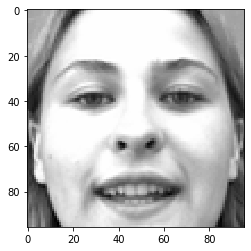

In [15]:
plt.imshow(X_train[7].reshape(96,96),cmap='gray')

In [16]:
X_train[7].reshape(96,96)

array([[178., 177., 178., ..., 177., 177., 177.],
       [177., 177., 178., ..., 178., 176., 174.],
       [178., 178., 178., ..., 175., 174., 175.],
       ...,
       [138., 146., 167., ...,  76.,  82., 106.],
       [134., 148., 169., ...,  86.,  73.,  90.],
       [132., 153., 178., ..., 100.,  72.,  74.]])

In [22]:
train=df_train.drop("Image",axis=1)
y_train=[]
for i in range(0,7049):
    y=train.iloc[i,:]
    y_train.append(y)
y_train

[left_eye_center_x            66.033564
 left_eye_center_y            39.002274
 right_eye_center_x           30.227008
 right_eye_center_y           36.421678
 left_eye_inner_corner_x      59.582075
 left_eye_inner_corner_y      39.647423
 left_eye_outer_corner_x      73.130346
 left_eye_outer_corner_y      39.969997
 right_eye_inner_corner_x     36.356571
 right_eye_inner_corner_y     37.389402
 right_eye_outer_corner_x     23.452872
 right_eye_outer_corner_y     37.389402
 left_eyebrow_inner_end_x     56.953263
 left_eyebrow_inner_end_y     29.033648
 left_eyebrow_outer_end_x     80.227128
 left_eyebrow_outer_end_y     32.228138
 right_eyebrow_inner_end_x    40.227609
 right_eyebrow_inner_end_y    29.002322
 right_eyebrow_outer_end_x    16.356379
 right_eyebrow_outer_end_y    29.647471
 nose_tip_x                   44.420571
 nose_tip_y                   57.066803
 mouth_left_corner_x          61.195308
 mouth_left_corner_y          79.970165
 mouth_right_corner_x         28.614496


In [20]:
y_train=np.array(y_train,dtype="float")
y_train

array([[66.03356391, 39.00227368, 30.22700752, ..., 72.93545865,
        43.13070677, 84.48577444],
       [64.33293617, 34.9700766 , 29.9492766 , ..., 70.26655319,
        45.46791489, 85.48017021],
       [65.05705263, 34.90964211, 30.90378947, ..., 70.19178947,
        47.27494737, 78.65936842],
       ...,
       [66.69073171, 36.84522146, 31.66641951, ..., 75.96359236,
        49.46257171, 78.11712   ],
       [70.96508235, 39.85366588, 30.54328471, ..., 75.96359236,
        50.06518588, 79.58644706],
       [66.93831111, 43.42450963, 31.09605926, ..., 75.96359236,
        45.90048   , 82.7730963 ]])

In [26]:
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Activation, MaxPooling2D, BatchNormalization, Flatten, Dense, Dropout, Conv2D
from tensorflow.python.framework import ops
ops.reset_default_graph()

In [27]:
model=Sequential()

In [32]:
model.add(Conv2D(54,(3,3),activation='relu',input_shape=(96,96,1)))
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(54,(3,3),activation='relu',input_shape=(96,96,1)))
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(54,(3,3),activation='relu',input_shape=(96,96,1)))
model.add(MaxPooling2D(pool_size=(2,2)))

In [33]:
model.add(Flatten())
model.add(Dense(100,activation='relu'))
model.add(Dropout(.2))
model.add(Dense(30))

In [34]:
model.compile(optimizer="adam",loss="mean_squared_error",metrics=["mae"])

In [35]:
model.fit(X_train,y_train,epochs = 50,batch_size = 256,validation_split = 0.2)

Train on 5639 samples, validate on 1410 samples
Epoch 1/50
5639/5639 [==============================] - 223s 40ms/sample - loss: 848.0794 - mae: 23.2986 - val_loss: 149.1274 - val_mae: 9.5075
Epoch 2/50
5639/5639 [==============================] - 136s 24ms/sample - loss: 337.5438 - mae: 14.6450 - val_loss: 135.1869 - val_mae: 8.7096
Epoch 3/50
5639/5639 [==============================] - 136s 24ms/sample - loss: 254.6875 - mae: 12.6753 - val_loss: 124.4688 - val_mae: 8.3288
Epoch 4/50
5639/5639 [==============================] - 135s 24ms/sample - loss: 215.2859 - mae: 11.5978 - val_loss: 108.7602 - val_mae: 7.6858
Epoch 5/50
5639/5639 [==============================] - 135s 24ms/sample - loss: 194.8746 - mae: 11.0078 - val_loss: 92.0532 - val_mae: 7.2786
Epoch 6/50
5639/5639 [==============================] - 135s 24ms/sample - loss: 183.9222 - mae: 10.6440 - val_loss: 139.5504 - val_mae: 9.2204
Epoch 7/50
5639/5639 [==============================] - 136s 24ms/sample - loss: 165.7758

In [36]:
test_df=pd.read_csv(r"facial-keypoints-detection\test.csv")
test_df.head()

,ImageId,Image
0,1,182 183 182 182 180 180 176 169 156 137 124 10...
1,2,76 87 81 72 65 59 64 76 69 42 31 38 49 58 58 4...
2,3,177 176 174 170 169 169 168 166 166 166 161 14...
3,4,176 174 174 175 174 174 176 176 175 171 165 15...
4,5,50 47 44 101 144 149 120 58 48 42 35 35 37 39 ...


In [37]:
test_df.isna().sum()

ImageId    0
Image      0
dtype: int64

In [39]:
test_df.shape

(1783, 2)

In [40]:
test=[]
for i in range(0,1783):
    img1=test_df["Image"][i].split(" ")
    img1=["0" if x=="" else x for x in img1]
    test.append(img1)

In [41]:
test_df=np.array(test, dtype="float")
X_test=test_df.reshape(-1,96,96,1)

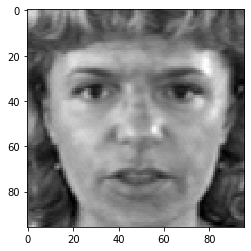

In [45]:
plt.imshow(X_test[7].reshape(96,96) ,cmap="gray")

In [46]:
pred=model.predict(X_test)

In [50]:
pred

array([[60.33286 , 34.3164  , 27.910582, ..., 67.771576, 43.82734 ,
        72.66576 ],
       [64.07509 , 36.35538 , 29.016293, ..., 72.15662 , 46.957363,
        76.51528 ],
       [59.306366, 33.655983, 27.512123, ..., 66.56941 , 43.44477 ,
        70.96198 ],
       ...,
       [61.682377, 35.206085, 27.705372, ..., 69.587166, 45.443962,
        73.18184 ],
       [62.57576 , 35.5224  , 28.206167, ..., 70.48655 , 45.988956,
        74.32657 ],
       [62.48397 , 35.550606, 28.121433, ..., 70.34586 , 46.019337,
        74.09053 ]], dtype=float32)